In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px


In [2]:
import warnings
warnings.filterwarnings("ignore")

In [3]:
data = pd.read_csv("data/data.csv")
df = data.copy()
artist_data = pd.read_csv("data/data_by_artist.csv")
genre_data = pd.read_csv('data/data_by_genres.csv')
year_data = pd.read_csv('data/data_by_year.csv')

## Prompt Engineering

After EDA, since the dataset is very clean and no serious multicollinearity, so we did not drop any variable. 

## Clustering for both genre and songs

### step 1: Standardization and K-means

In [4]:
genre_data

,mode,genres,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
0,1,21st century classical,0.979333,0.162883,1.602977e+05,0.071317,0.606834,0.361600,-31.514333,0.040567,75.336500,0.103783,27.833333,6
1,1,432hz,0.494780,0.299333,1.048887e+06,0.450678,0.477762,0.131000,-16.854000,0.076817,120.285667,0.221750,52.500000,5
2,1,8-bit,0.762000,0.712000,1.151770e+05,0.818000,0.876000,0.126000,-9.180000,0.047000,133.444000,0.975000,48.000000,7
3,1,[],0.651417,0.529093,2.328809e+05,0.419146,0.205309,0.218696,-12.288965,0.107872,112.857352,0.513604,20.859882,7
4,1,a cappella,0.676557,0.538961,1.906285e+05,0.316434,0.003003,0.172254,-12.479387,0.082851,112.110362,0.448249,45.820071,7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2968,1,zolo,0.222625,0.547082,2.580991e+05,0.610240,0.143872,0.204206,-11.295878,0.061088,125.494919,0.596155,33.778943,9
2969,0,zouglou,0.161000,0.863000,2.063200e+05,0.909000,0.000000,0.108000,-5.985000,0.081300,119.038000,0.845000,58.000000,7
2970,1,zouk,0.263261,0.748889,3.060728e+05,0.622444,0.257227,0.089678,-10.289222,0.038778,101.965222,0.824111,46.666667,5
2971,0,zurich indie,0.993000,0.705667,1.984173e+05,0.172667,0.468633,0.179667,-11.453333,0.348667,91.278000,0.739000,0.000000,7


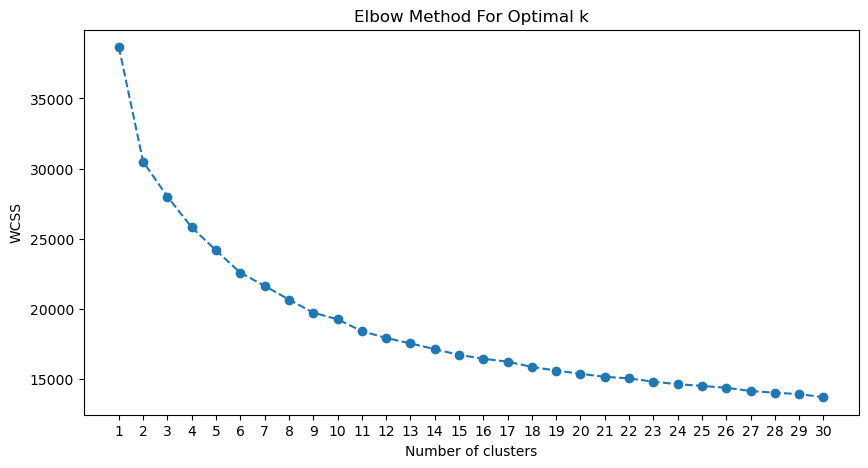

In [5]:
#find the best n_clusters for genre
import numpy as np
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.pipeline import Pipeline
import matplotlib.pyplot as plt


X = genre_data.select_dtypes(np.number)  # Selecting numerical columns

# Range of potential clusters
clusters_range = range(1, 31)
wcss = []

for n_clusters in clusters_range:
    pipeline = Pipeline([
        ('scaler', StandardScaler()),
        ('kmeans', KMeans(n_clusters=n_clusters, init='k-means++', max_iter=300, n_init=10, random_state=0))
    ])
    pipeline.fit(X)
    wcss.append(pipeline.named_steps['kmeans'].inertia_)

# Plotting the Elbow Method graph
plt.figure(figsize=(10, 5))
plt.plot(clusters_range, wcss, marker='o', linestyle='--')
plt.title('Elbow Method For Optimal k')
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')
plt.xticks(clusters_range)
plt.show()

Thus, from the graph, it seems that the best n_clusters for genre=15

In [6]:
df

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo
0,0.0594,1921,0.98200,"['Sergei Rachmaninoff', 'James Levine', 'Berli...",0.279,831667,0.211,0,4BJqT0PrAfrxzMOxytFOIz,0.878000,10,0.6650,-20.096,1,"Piano Concerto No. 3 in D Minor, Op. 30: III. ...",4,1921,0.0366,80.954
1,0.9630,1921,0.73200,['Dennis Day'],0.819,180533,0.341,0,7xPhfUan2yNtyFG0cUWkt8,0.000000,7,0.1600,-12.441,1,Clancy Lowered the Boom,5,1921,0.4150,60.936
2,0.0394,1921,0.96100,['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...,0.328,500062,0.166,0,1o6I8BglA6ylDMrIELygv1,0.913000,3,0.1010,-14.850,1,Gati Bali,5,1921,0.0339,110.339
3,0.1650,1921,0.96700,['Frank Parker'],0.275,210000,0.309,0,3ftBPsC5vPBKxYSee08FDH,0.000028,5,0.3810,-9.316,1,Danny Boy,3,1921,0.0354,100.109
4,0.2530,1921,0.95700,['Phil Regan'],0.418,166693,0.193,0,4d6HGyGT8e121BsdKmw9v6,0.000002,3,0.2290,-10.096,1,When Irish Eyes Are Smiling,2,1921,0.0380,101.665
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
170648,0.6080,2020,0.08460,"['Anuel AA', 'Daddy Yankee', 'KAROL G', 'Ozuna...",0.786,301714,0.808,0,0KkIkfsLEJbrcIhYsCL7L5,0.000289,7,0.0822,-3.702,1,China,72,2020-05-29,0.0881,105.029
170649,0.7340,2020,0.20600,['Ashnikko'],0.717,150654,0.753,0,0OStKKAuXlxA0fMH54Qs6E,0.000000,7,0.1010,-6.020,1,Halloweenie III: Seven Days,68,2020-10-23,0.0605,137.936
170650,0.6370,2020,0.10100,['MAMAMOO'],0.634,211280,0.858,0,4BZXVFYCb76Q0Klojq4piV,0.000009,4,0.2580,-2.226,0,AYA,76,2020-11-03,0.0809,91.688
170651,0.1950,2020,0.00998,['Eminem'],0.671,337147,0.623,1,5SiZJoLXp3WOl3J4C8IK0d,0.000008,2,0.6430,-7.161,1,Darkness,70,2020-01-17,0.3080,75.055


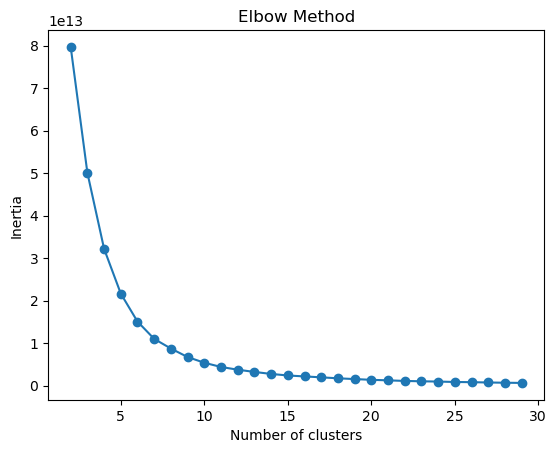

In [7]:
#for song, since this dataset is so large, we will use Subsampling and Elbow Method to find optimal k

from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

X = df.select_dtypes(np.number) 

sample_size = 10000  

# Randomly sample from your large dataset
sampled_data = X.sample(n=sample_size, random_state=0)

# Choose a range of cluster numbers to evaluate
cluster_range = range(2, 30)

inertia_values = []

# Iterate over each cluster number and calculate inertia
for n_clusters in cluster_range:
    kmeans = KMeans(n_clusters=n_clusters, random_state=0)
    kmeans.fit(sampled_data)
    inertia_values.append(kmeans.inertia_)

# Plot the elbow curve
plt.plot(cluster_range, inertia_values, marker='o')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')
plt.title('Elbow Method')
plt.show()

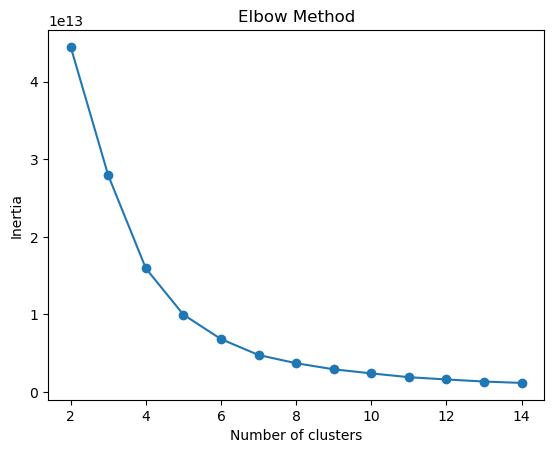

In [8]:
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

X = df.select_dtypes(np.number) 

sample_size = 5000 

# Randomly sample from your large dataset
sampled_data = X.sample(n=sample_size, random_state=0)

# Choose a range of cluster numbers to evaluate
cluster_range = range(2, 15)

inertia_values = []

# Iterate over each cluster number and calculate inertia
for n_clusters in cluster_range:
    kmeans = KMeans(n_clusters=n_clusters, random_state=0)
    kmeans.fit(sampled_data)
    inertia_values.append(kmeans.inertia_)

# Plot the elbow curve
plt.plot(cluster_range, inertia_values, marker='o')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')
plt.title('Elbow Method')
plt.show()

the optimal number for this subsampling is 10. Since we did subsampling, probably 30 is a good number to use.

In [9]:
kmeans_pipeline = Pipeline([
    ('scaler', StandardScaler()),
    ('kmeans', KMeans(n_clusters=15))
])

song_kmeans_pipeline = Pipeline([
    ('scaler', StandardScaler()),
    ('kmeans', KMeans(n_clusters=30))
])

In [10]:
X = genre_data.select_dtypes(np.number)
kmeans_pipeline.fit(X)
genre_data['Cluster_Number'] = kmeans_pipeline.predict(X)

### step 2: Dimensionality Reduction 

### T-SNE -genre

In [11]:
from sklearn.manifold import TSNE
tsne_pipeline = Pipeline([
    ('scaler', StandardScaler()), 
    ('tsne', TSNE(n_components=2, verbose=False))
])

genre_embedding = tsne_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=genre_embedding)

projection['title'] = genre_data.genres
projection['cluster'] = genre_data.Cluster_Number

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'title'],
    color_discrete_sequence=px.colors.sequential.Cividis
)

fig.show()

### UMAP - genre

In [12]:
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
import pandas as pd
import plotly.express as px
from umap import UMAP # Make sure to install umap-learn

umap_pipeline = Pipeline([
    ('scaler', StandardScaler()),
    ('umap', UMAP(n_components=2))  # Default parameters for UMAP
])

# Fit and transform your data using UMAP
genre_embedding = umap_pipeline.fit_transform(X)

# Create a DataFrame for the projection
projection = pd.DataFrame(columns=['x', 'y'], data=genre_embedding)


projection['title'] = genre_data.genres
projection['cluster'] = genre_data.Cluster_Number


fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'title'],
    color_discrete_sequence=px.colors.sequential.Cividis  
)

fig.show()

### PCA - songs

since this song dataset is extremely large, we will use PCA here to visualize the dataset.

In [13]:
df.head()

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo
0,0.0594,1921,0.982,"['Sergei Rachmaninoff', 'James Levine', 'Berli...",0.279,831667,0.211,0,4BJqT0PrAfrxzMOxytFOIz,0.878000,10,0.665,-20.096,1,"Piano Concerto No. 3 in D Minor, Op. 30: III. ...",4,1921,0.0366,80.954
1,0.9630,1921,0.732,['Dennis Day'],0.819,180533,0.341,0,7xPhfUan2yNtyFG0cUWkt8,0.000000,7,0.160,-12.441,1,Clancy Lowered the Boom,5,1921,0.4150,60.936
2,0.0394,1921,0.961,['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...,0.328,500062,0.166,0,1o6I8BglA6ylDMrIELygv1,0.913000,3,0.101,-14.850,1,Gati Bali,5,1921,0.0339,110.339
3,0.1650,1921,0.967,['Frank Parker'],0.275,210000,0.309,0,3ftBPsC5vPBKxYSee08FDH,0.000028,5,0.381,-9.316,1,Danny Boy,3,1921,0.0354,100.109
4,0.2530,1921,0.957,['Phil Regan'],0.418,166693,0.193,0,4d6HGyGT8e121BsdKmw9v6,0.000002,3,0.229,-10.096,1,When Irish Eyes Are Smiling,2,1921,0.0380,101.665


In [14]:
X = df.select_dtypes(np.number)

song_kmeans_pipeline.fit(X)
song_clusters = song_kmeans_pipeline.predict(X)
df['Cluster_Number'] = song_clusters

In [15]:
from sklearn.decomposition import PCA

pca_pipeline = Pipeline([
    ('scaler', StandardScaler()),
    ('PCA', PCA(n_components = 2))
])

song_embedding = pca_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=song_embedding)

projection['title'] = df.name
projection['cluster'] = df.Cluster_Number

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'title'])
fig.show()

### Step3: Let us explore the features of clusters for genre

### genre

In [16]:
genre_data

,mode,genres,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key,Cluster_Number
0,1,21st century classical,0.979333,0.162883,1.602977e+05,0.071317,0.606834,0.361600,-31.514333,0.040567,75.336500,0.103783,27.833333,6,0
1,1,432hz,0.494780,0.299333,1.048887e+06,0.450678,0.477762,0.131000,-16.854000,0.076817,120.285667,0.221750,52.500000,5,7
2,1,8-bit,0.762000,0.712000,1.151770e+05,0.818000,0.876000,0.126000,-9.180000,0.047000,133.444000,0.975000,48.000000,7,6
3,1,[],0.651417,0.529093,2.328809e+05,0.419146,0.205309,0.218696,-12.288965,0.107872,112.857352,0.513604,20.859882,7,11
4,1,a cappella,0.676557,0.538961,1.906285e+05,0.316434,0.003003,0.172254,-12.479387,0.082851,112.110362,0.448249,45.820071,7,12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2968,1,zolo,0.222625,0.547082,2.580991e+05,0.610240,0.143872,0.204206,-11.295878,0.061088,125.494919,0.596155,33.778943,9,8
2969,0,zouglou,0.161000,0.863000,2.063200e+05,0.909000,0.000000,0.108000,-5.985000,0.081300,119.038000,0.845000,58.000000,7,1
2970,1,zouk,0.263261,0.748889,3.060728e+05,0.622444,0.257227,0.089678,-10.289222,0.038778,101.965222,0.824111,46.666667,5,2
2971,0,zurich indie,0.993000,0.705667,1.984173e+05,0.172667,0.468633,0.179667,-11.453333,0.348667,91.278000,0.739000,0.000000,7,11


In [17]:
import seaborn as sns
import matplotlib.pyplot as plt

numerical_genre = genre_data.select_dtypes(np.number)


# Calculate the mean for each cluster
cluster_centers = numerical_genre.groupby('Cluster_Number').mean()
print(cluster_centers)

                    mode  acousticness  danceability   duration_ms    energy  \
Cluster_Number                                                                 
0               0.835366      0.886382      0.295024  2.951479e+05  0.135432   
1               0.000000      0.299741      0.668018  2.327436e+05  0.630381   
2               1.000000      0.228505      0.666851  2.420464e+05  0.672674   
3               0.844720      0.192010      0.545084  3.371002e+05  0.646464   
4               0.971751      0.204776      0.716118  2.358385e+05  0.671178   
5               0.732143      0.445467      0.496133  3.079328e+05  0.598984   
6               1.000000      0.563588      0.595668  2.051891e+05  0.508447   
7               0.666667      0.793797      0.342936  1.558904e+06  0.308902   
8               1.000000      0.117540      0.466680  2.431611e+05  0.786911   
9               1.000000      0.137674      0.498341  2.476998e+05  0.750048   
10              0.903226      0.866761  

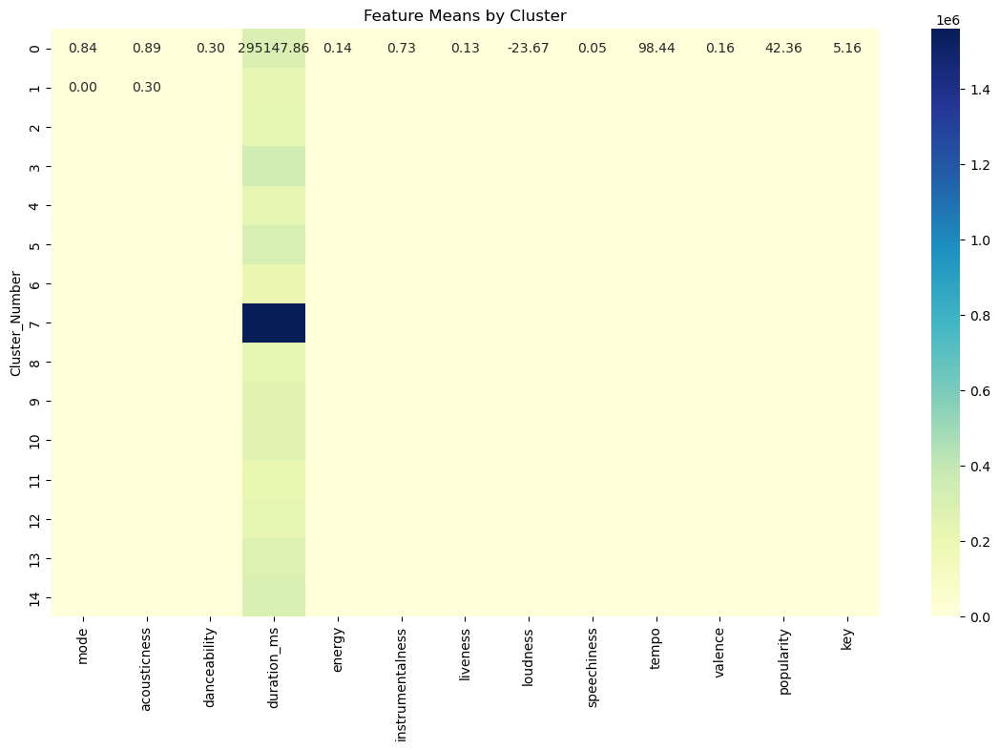

In [18]:
# Plot the cluster centers for each feature
plt.figure(figsize=(14, 8))
sns.heatmap(cluster_centers, annot=True, fmt=".2f", cmap="YlGnBu")
plt.title('Feature Means by Cluster')
plt.show()

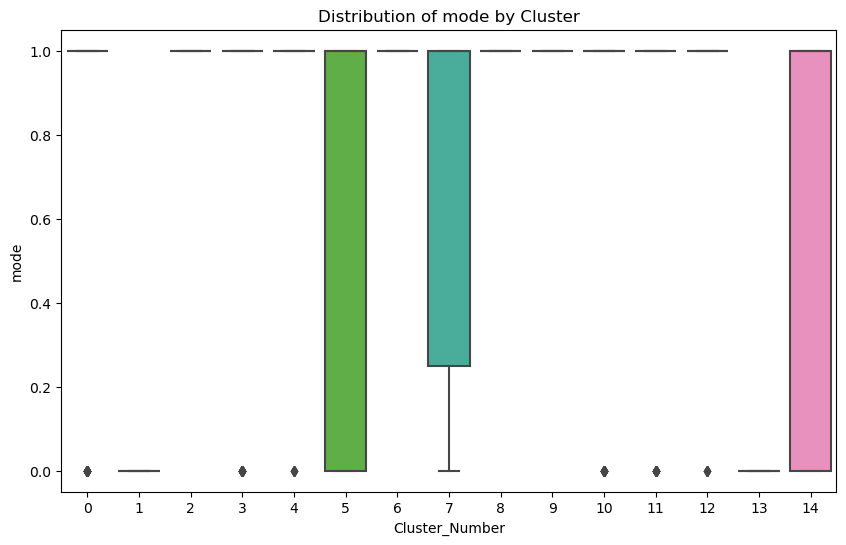

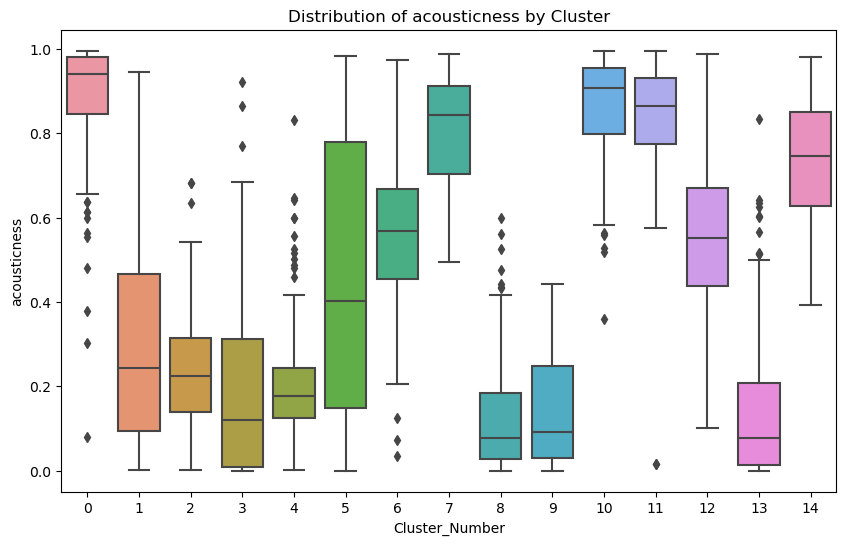

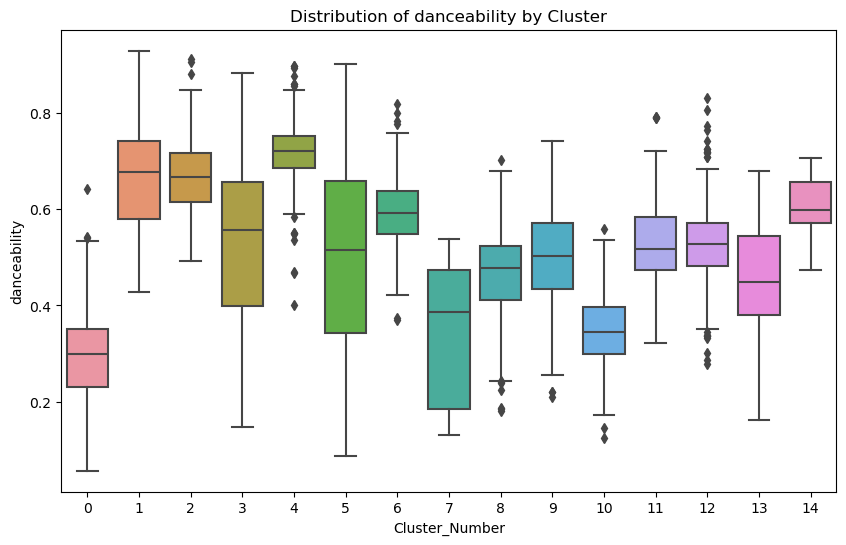

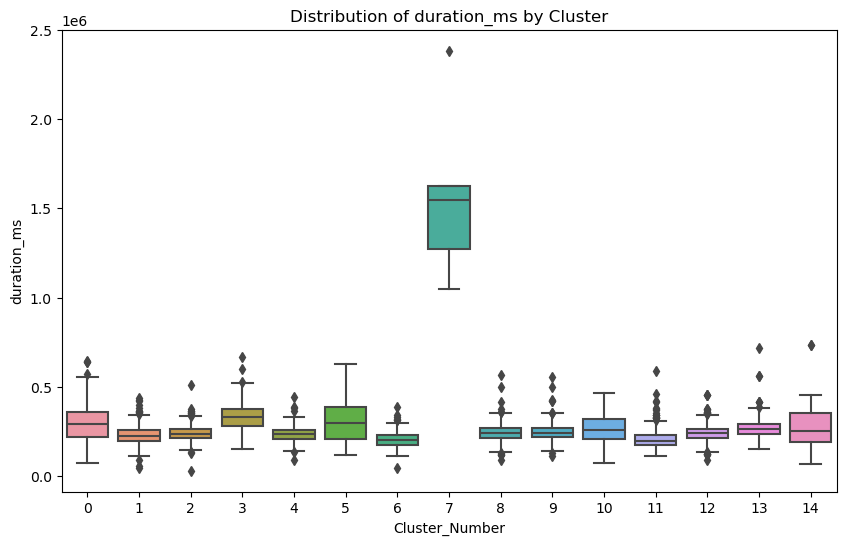

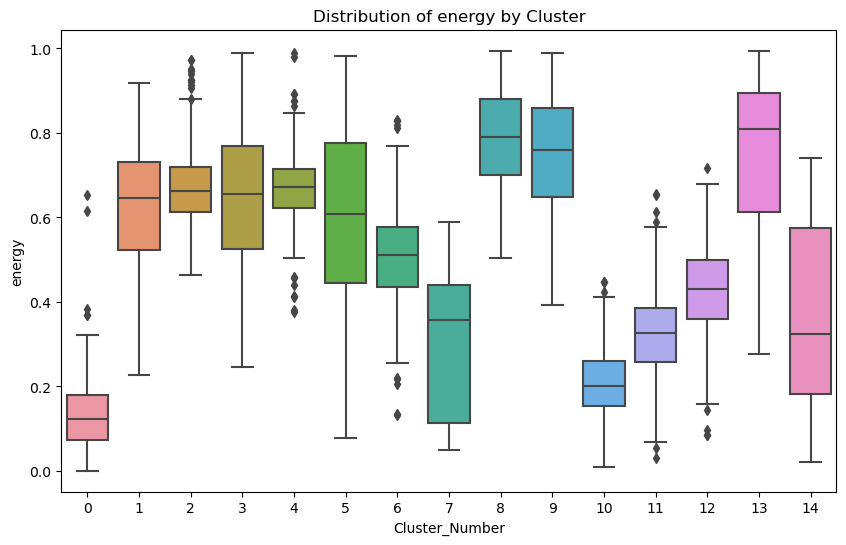

...

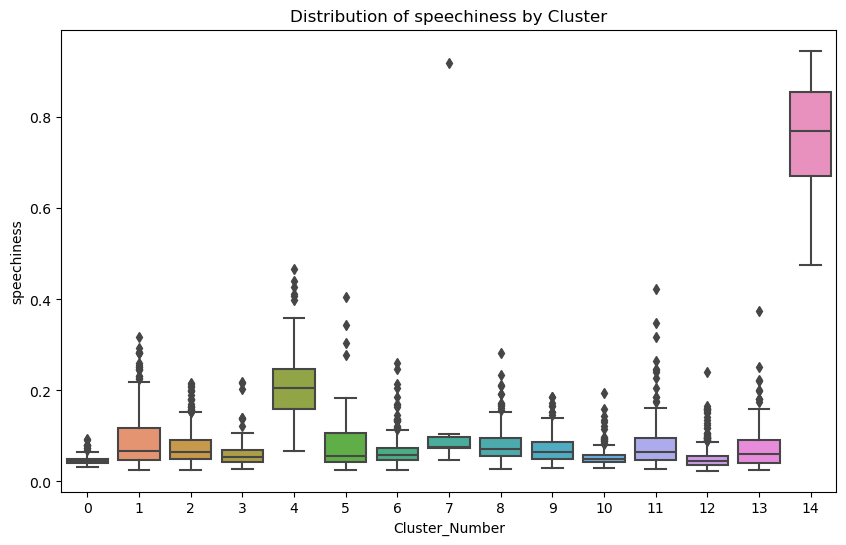

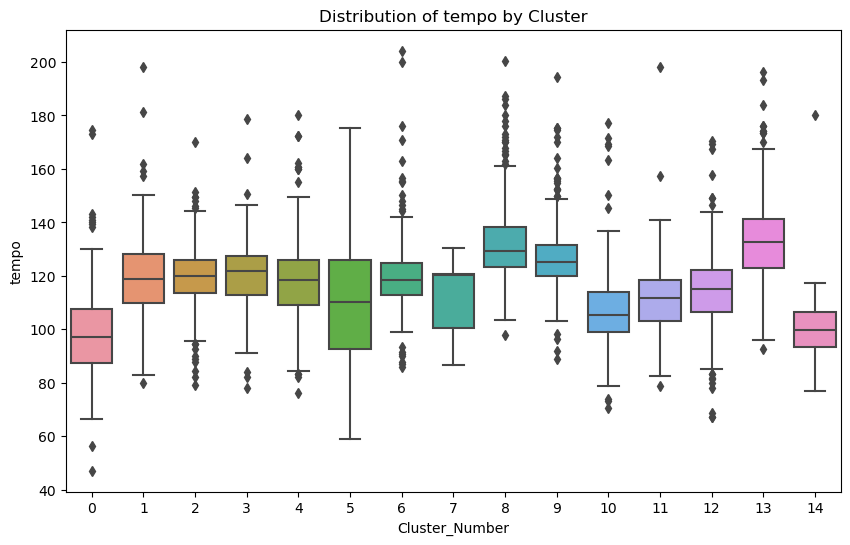

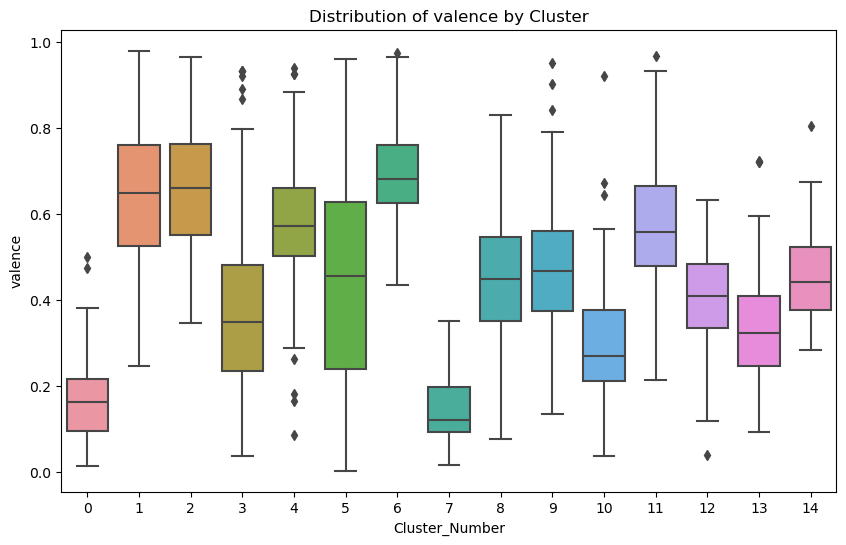

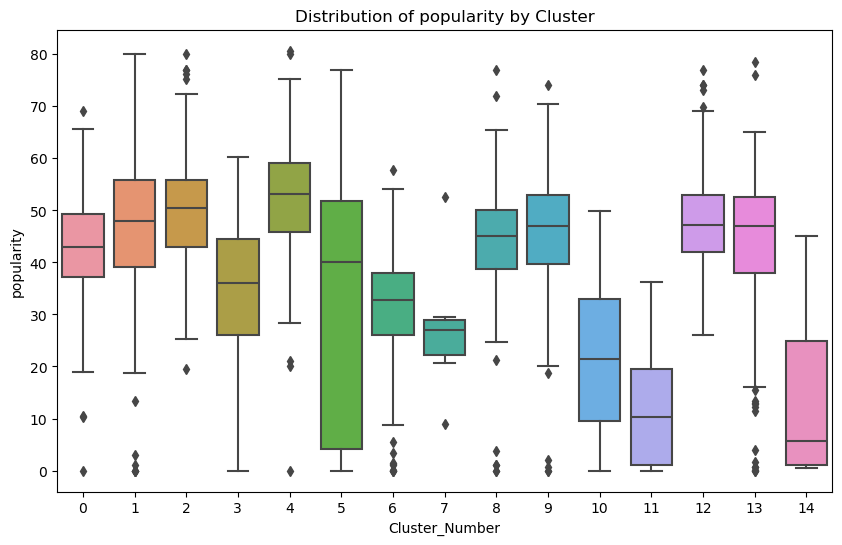

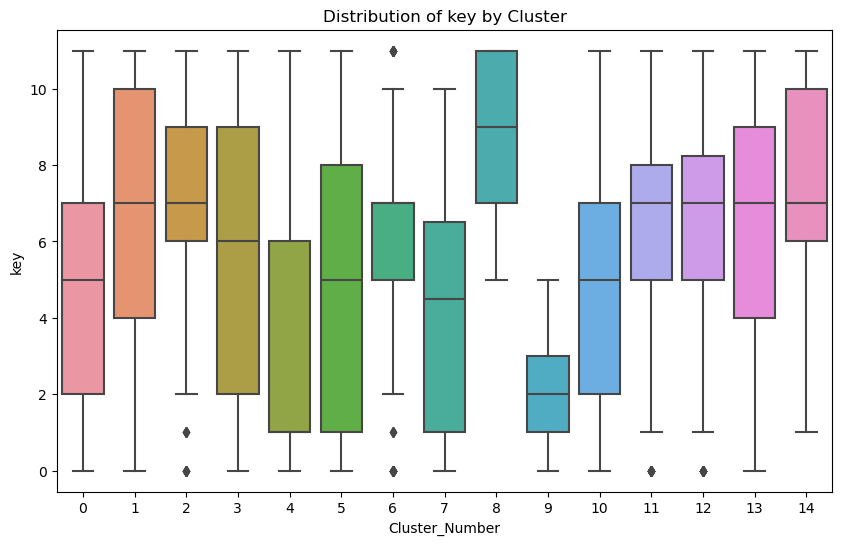

In [19]:
for feature in cluster_centers.columns:
    plt.figure(figsize=(10, 6))
    sns.boxplot(x='Cluster_Number', y=feature, data=genre_data)
    plt.title(f'Distribution of {feature} by Cluster')
    plt.show()

Genre Clusters Takeaways:


Cluster 0
- Key Features: Low acousticness, high energy.
- Possible Genre Characteristics: This cluster might represent genres that are electric, energetic, and less - focused on acoustic instruments.

Cluster 1
- Key Features: High mode, relatively high danceability, low energy.
- Possible Genre Characteristics: This cluster could represent genres with a major key predominance, danceable rhythms but not very loud or energetic, possibly including pop genres.


Cluster 2
- Key Features: Moderate acousticness and energy.
- Possible Genre Characteristics: Genres in this cluster may balance acoustic and electronic elements and have a moderate energy level, which could be indicative of genres like indie pop.


Cluster 3
- Key Features: High acousticness, low energy, and low valence.
- Possible Genre Characteristics: This suggests genres that are more acoustic and instrumental, with a softer and more melancholic tone, such as folk or classical.


Cluster 4
- Key Features: High acousticness, moderate danceability.
- Possible Genre Characteristics: This cluster might consist of acoustic and danceable music, which could include certain types of world music or acoustic pop.


Cluster 5
- Key Features: High acousticness, low danceability, and energy.
- Possible Genre Characteristics: Genres in this cluster are likely to be acoustic with less focus on rhythm, possibly classical or ambient music.


Cluster 6
- Key Features: High danceability, high valence.
- Possible Genre Characteristics: This cluster represents genres that are likely very rhythmic and positive, such as dance pop or upbeat electronic music.


Cluster 7
- Key Features: High instrumentalness, low liveness.
- Possible Genre Characteristics: This suggests genres with a focus on instrumentals over vocals, possibly studio-produced music or electronic genres.


Cluster 8
- Key Features: Low speechiness, high tempo.
- Possible Genre Characteristics: Genres here are less focused on vocals, with fast tempo, which could be associated with electronic dance music.


Cluster 9
- Key Features: High danceability, high energy.
- Possible Genre Characteristics: This cluster likely includes danceable and high-energy genres, such as EDM or pop.


Cluster 10
- Key Features: Low valence, low popularity.
- Possible Genre Characteristics: This suggests genres that are less happy and potentially less mainstream or popular.


Cluster 11
- Key Features: High acousticness, low popularity.
- Possible Genre Characteristics: Genres in this cluster might not be mainstream and have a strong focus on acoustic instruments, such as folk or indie.


Cluster 12
- Key Features: High valence, moderate tempo.
- Possible Genre Characteristics: This cluster could represent happy, positive music that's not particularly fast-paced, possibly including genres like pop or soft rock.


Cluster 13
- Key Features: Low mode, low danceability.
- Possible Genre Characteristics: Genres here might have a more serious or somber tone with less focus on danceability, such as ballads or certain types of rock.


Cluster 14
- Key Features: High liveness, low instrumentalness.
- Possible Genre Characteristics: This cluster may include genres with a live performance focus and significant vocal content, like live recordings of rock or pop music.

### Most popular genres

In [20]:
genre_data

,mode,genres,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key,Cluster_Number
0,1,21st century classical,0.979333,0.162883,1.602977e+05,0.071317,0.606834,0.361600,-31.514333,0.040567,75.336500,0.103783,27.833333,6,0
1,1,432hz,0.494780,0.299333,1.048887e+06,0.450678,0.477762,0.131000,-16.854000,0.076817,120.285667,0.221750,52.500000,5,7
2,1,8-bit,0.762000,0.712000,1.151770e+05,0.818000,0.876000,0.126000,-9.180000,0.047000,133.444000,0.975000,48.000000,7,6
3,1,[],0.651417,0.529093,2.328809e+05,0.419146,0.205309,0.218696,-12.288965,0.107872,112.857352,0.513604,20.859882,7,11
4,1,a cappella,0.676557,0.538961,1.906285e+05,0.316434,0.003003,0.172254,-12.479387,0.082851,112.110362,0.448249,45.820071,7,12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2968,1,zolo,0.222625,0.547082,2.580991e+05,0.610240,0.143872,0.204206,-11.295878,0.061088,125.494919,0.596155,33.778943,9,8
2969,0,zouglou,0.161000,0.863000,2.063200e+05,0.909000,0.000000,0.108000,-5.985000,0.081300,119.038000,0.845000,58.000000,7,1
2970,1,zouk,0.263261,0.748889,3.060728e+05,0.622444,0.257227,0.089678,-10.289222,0.038778,101.965222,0.824111,46.666667,5,2
2971,0,zurich indie,0.993000,0.705667,1.984173e+05,0.172667,0.468633,0.179667,-11.453333,0.348667,91.278000,0.739000,0.000000,7,11


In [21]:
cluster_popularity_avg = genre_data.groupby("Cluster_Number")["popularity"].mean().reset_index()
cluster_popularity_avg_sorted = cluster_popularity_avg.sort_values(by="popularity", ascending=False)
cluster_popularity_avg_sorted

,Cluster_Number,popularity
4,4,52.397887
2,2,49.901947
12,12,47.541180
1,1,47.252025
9,9,45.685312
8,8,44.560995
13,13,43.433441
0,0,42.362939
5,5,34.108127
6,6,31.502689


### Takeaway:
top 5 popular clusters are cluster 0,cluster 5, cluster 8, 9, and 6: It seems that high energy and more dynamic songs are most popular genres.

- Cluster 0

Key Features: Low acousticness, high energy.


- Cluster 5

Key Features: High acousticness, low danceability, and energy.

- Cluster 8

Key Features: Low speechiness, high tempo.

- Cluster 9

Key Features: High danceability, high energy.

- Cluster 6

Key Features: High danceability, high valence.

### Step4: Let us explore the features of clusters for songs

### Songs

In [22]:
df

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo,Cluster_Number
0,0.0594,1921,0.98200,"['Sergei Rachmaninoff', 'James Levine', 'Berli...",0.279,831667,0.211,0,4BJqT0PrAfrxzMOxytFOIz,0.878000,10,0.6650,-20.096,1,"Piano Concerto No. 3 in D Minor, Op. 30: III. ...",4,1921,0.0366,80.954,14
1,0.9630,1921,0.73200,['Dennis Day'],0.819,180533,0.341,0,7xPhfUan2yNtyFG0cUWkt8,0.000000,7,0.1600,-12.441,1,Clancy Lowered the Boom,5,1921,0.4150,60.936,12
2,0.0394,1921,0.96100,['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...,0.328,500062,0.166,0,1o6I8BglA6ylDMrIELygv1,0.913000,3,0.1010,-14.850,1,Gati Bali,5,1921,0.0339,110.339,4
3,0.1650,1921,0.96700,['Frank Parker'],0.275,210000,0.309,0,3ftBPsC5vPBKxYSee08FDH,0.000028,5,0.3810,-9.316,1,Danny Boy,3,1921,0.0354,100.109,16
4,0.2530,1921,0.95700,['Phil Regan'],0.418,166693,0.193,0,4d6HGyGT8e121BsdKmw9v6,0.000002,3,0.2290,-10.096,1,When Irish Eyes Are Smiling,2,1921,0.0380,101.665,16
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
170648,0.6080,2020,0.08460,"['Anuel AA', 'Daddy Yankee', 'KAROL G', 'Ozuna...",0.786,301714,0.808,0,0KkIkfsLEJbrcIhYsCL7L5,0.000289,7,0.0822,-3.702,1,China,72,2020-05-29,0.0881,105.029,18
170649,0.7340,2020,0.20600,['Ashnikko'],0.717,150654,0.753,0,0OStKKAuXlxA0fMH54Qs6E,0.000000,7,0.1010,-6.020,1,Halloweenie III: Seven Days,68,2020-10-23,0.0605,137.936,18
170650,0.6370,2020,0.10100,['MAMAMOO'],0.634,211280,0.858,0,4BZXVFYCb76Q0Klojq4piV,0.000009,4,0.2580,-2.226,0,AYA,76,2020-11-03,0.0809,91.688,22
170651,0.1950,2020,0.00998,['Eminem'],0.671,337147,0.623,1,5SiZJoLXp3WOl3J4C8IK0d,0.000008,2,0.6430,-7.161,1,Darkness,70,2020-01-17,0.3080,75.055,3


#### see which which name is most popular for each cluster

In [23]:
cluster_avg_popularity = df.groupby('Cluster_Number')['popularity'].mean().reset_index()
cluster_avg_popularity = cluster_avg_popularity.sort_values(by='popularity', ascending=False)
cluster_mode_name = df.groupby('Cluster_Number')['name'].agg(lambda x: x.mode()[0] if not x.mode().empty else None).reset_index()
cluster_merged = pd.merge(cluster_avg_popularity, cluster_mode_name, on='Cluster_Number', how='left')
cluster_merged.columns = ['Cluster_Number', 'Average_Popularity', 'Name']
cluster_merged

,Cluster_Number,Average_Popularity,Name
0,9,55.542766,Lonely
1,3,54.369233,Intro
2,18,53.164604,Limbo
3,27,47.561060,Without You
4,11,47.489499,Come As You Are
5,22,46.475501,Eye of the Tiger
6,1,44.454705,Have Yourself a Merry Little Christmas
7,20,44.390575,Hello
8,17,44.300917,Main Title
9,2,43.443308,A Ella


#### see which which artist is most popular for each cluster

In [24]:
cluster_avg_popularity = df.groupby('Cluster_Number')['popularity'].mean().reset_index()
cluster_avg_popularity = cluster_avg_popularity.sort_values(by='popularity', ascending=False)
cluster_mode_name = df.groupby('Cluster_Number')['artists'].agg(lambda x: x.mode()[0] if not x.mode().empty else None).reset_index()
cluster_merged = pd.merge(cluster_avg_popularity, cluster_mode_name, on='Cluster_Number', how='left')
cluster_merged.columns = ['Cluster_Number', 'Average_Popularity', 'artists']
cluster_merged

,Cluster_Number,Average_Popularity,artists
0,9,55.542766,['Eminem']
1,3,54.369233,['Eminem']
2,18,53.164604,['Taylor Swift']
3,27,47.561060,['Queen']
4,11,47.489499,['Metallica']
5,22,46.475501,['BTS']
6,1,44.454705,['Vicente Fernández']
7,20,44.390575,['Bob Marley & The Wailers']
8,17,44.300917,['John Williams']
9,2,43.443308,['Ramones']


we should recommend customers in each cluster with the most popular artist or song in that cluster